In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns


%matplotlib inline

In [ ]:
# Prepare the codes
!git clone https://github.com/phil-bergmann/tracking_wo_bnw

# install packages
!pip install -r tracking_wo_bnw/requirements.txt

# install tracktor
!pip install -e tracking_wo_bnw/.

Cloning into 'tracking_wo_bnw'...
remote: Enumerating objects: 2131, done.
remote: Counting objects: 100% (273/273), done.
remote: Compressing objects: 100% (180/180), done.
remote: Total 2131 (delta 158), reused 171 (delta 93), pack-reused 1858
Receiving objects: 100% (2131/2131), 6.22 MiB | 17.31 MiB/s, done.
Resolving deltas: 100% (1343/1343), done.
     |████████████████████████████████| 127 kB 8.7 MB/s 
     |████████████████████████████████| 213 kB 42.8 MB/s 
     |████████████████████████████████| 101 kB 10.0 MB/s 
     |████████████████████████████████| 283 kB 47.7 MB/s 
     |████████████████████████████████| 147 kB 53.3 MB/s 
     |████████████████████████████████| 178 kB 54.8 MB/s 
     |████████████████████████████████| 2.1 MB 52.0 MB/s 
     |████████████████████████████████| 73 kB 1.6 MB/s 
     |████████████████████████████████| 829 kB 50.4 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done


In [ ]:
% cd tracking_wo_bnw/

/content/tracking_wo_bnw


### Download MOT 17 Dataset

In [ ]:
# Prepare MOT-17Det datasets

%%shell

# download the MOT17 detection challenge
wget https://motchallenge.net/data/MOT17Det.zip .
# extract it in the current folder
unzip -q MOT17Det.zip

--2021-11-27 18:12:03--  https://motchallenge.net/data/MOT17Det.zip
Resolving motchallenge.net (motchallenge.net)... 131.159.19.34, 2a09:80c0:18::1034
Connecting to motchallenge.net (motchallenge.net)|131.159.19.34|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1952547113 (1.8G) [application/zip]
Saving to: ‘MOT17Det.zip’

MOT17Det.zip        100%[===================>]   1.82G  13.0MB/s    in 1m 58s  

2021-11-27 18:14:02 (15.7 MB/s) - ‘MOT17Det.zip’ saved [1952547113/1952547113]

--2021-11-27 18:14:02--  http://./
Resolving . (.)... failed: No address associated with hostname.
wget: unable to resolve host address ‘.’
FINISHED --2021-11-27 18:14:02--
Total wall clock time: 1m 59s
Downloaded: 1 files, 1.8G in 1m 58s (15.7 MB/s)


In [ ]:
# Prepare MOT-17 label datasets

%%shell

wget https://motchallenge.net/data/MOT17Labels.zip .
unzip -q -d data/MOT17Labels MOT17Labels.zip
unzip -q -d data/MOT17Det MOT17Det.zip

--2021-11-27 18:14:42--  https://motchallenge.net/data/MOT17Labels.zip
Resolving motchallenge.net (motchallenge.net)... 131.159.19.34, 2a09:80c0:18::1034
Connecting to motchallenge.net (motchallenge.net)|131.159.19.34|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 10107022 (9.6M) [application/zip]
Saving to: ‘MOT17Labels.zip’

MOT17Labels.zip     100%[===================>]   9.64M  6.27MB/s    in 1.5s    

2021-11-27 18:14:44 (6.27 MB/s) - ‘MOT17Labels.zip’ saved [10107022/10107022]

--2021-11-27 18:14:44--  http://./
Resolving . (.)... failed: No address associated with hostname.
wget: unable to resolve host address ‘.’
FINISHED --2021-11-27 18:14:44--
Total wall clock time: 2.2s
Downloaded: 1 files, 9.6M in 1.5s (6.27 MB/s)


In [ ]:
# Obtain the ground truth and pre-trained model files

%%shell

wget https://vision.in.tum.de/webshare/u/meinhard/tracking_wo_bnw-output_v3.zip .
unzip -q tracking_wo_bnw-output_v3.zip 

--2021-11-27 18:15:49--  https://vision.in.tum.de/webshare/u/meinhard/tracking_wo_bnw-output_v3.zip
Resolving vision.in.tum.de (vision.in.tum.de)... 131.159.19.110, 2a09:80c0:18::1110
Connecting to vision.in.tum.de (vision.in.tum.de)|131.159.19.110|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 501071552 (478M) [application/zip]
Saving to: ‘tracking_wo_bnw-output_v3.zip’

tracking_wo_bnw-out 100%[===================>] 477.86M  18.5MB/s    in 28s     

2021-11-27 18:16:17 (17.2 MB/s) - ‘tracking_wo_bnw-output_v3.zip’ saved [501071552/501071552]

--2021-11-27 18:16:17--  http://./
Resolving . (.)... failed: No address associated with hostname.
wget: unable to resolve host address ‘.’
FINISHED --2021-11-27 18:16:17--
Total wall clock time: 29s
Downloaded: 1 files, 478M in 28s (17.2 MB/s)


Let's have a look at the dataset and how it is layed down.

The data is structured as follows

In [ ]:
%%shell

ls
ls train
ls test

ls train/MOT17-02/
ls train/MOT17-02/img1/

data	     MOT17Det.zip     requirements.txt	test
experiments  MOT17Labels.zip  setup.py		tracking_wo_bnw-output_v3.zip
LICENSE      output	      src		train
__MACOSX     README.md	      tensorboard
MOT17-02  MOT17-04  MOT17-05  MOT17-09	MOT17-10  MOT17-11  MOT17-13
MOT17-01  MOT17-03  MOT17-06  MOT17-07	MOT17-08  MOT17-12  MOT17-14
gt  img1  seqinfo.ini
000001.jpg  000101.jpg	000201.jpg  000301.jpg	000401.jpg  000501.jpg
000002.jpg  000102.jpg	000202.jpg  000302.jpg	000402.jpg  000502.jpg
000003.jpg  000103.jpg	000203.jpg  000303.jpg	000403.jpg  000503.jpg
000004.jpg  000104.jpg	000204.jpg  000304.jpg	000404.jpg  000504.jpg
000005.jpg  000105.jpg	000205.jpg  000305.jpg	000405.jpg  000505.jpg
000006.jpg  000106.jpg	000206.jpg  000306.jpg	000406.jpg  000506.jpg
000007.jpg  000107.jpg	000207.jpg  000307.jpg	000407.jpg  000507.jpg
000008.jpg  000108.jpg	000208.jpg  000308.jpg	000408.jpg  000508.jpg
000009.jpg  000109.jpg	000209.jpg  000309.jpg	000409.jpg  000509.jpg
000010.jpg  000110.jpg	0

(5 points) Visualize some images in the MOT-17 dataset. 

In [ ]:
def display_grid(imgs, height, width):
  fig, axs = plt.subplots(height, width, figsize = (20, 20))
  plt.gray()

  # loop through subplots and add mnist images
  for i, ax in enumerate(axs.flat):
    img = plt.imread(imgs[i])
    ax.grid(False)
    ax.imshow(img)  

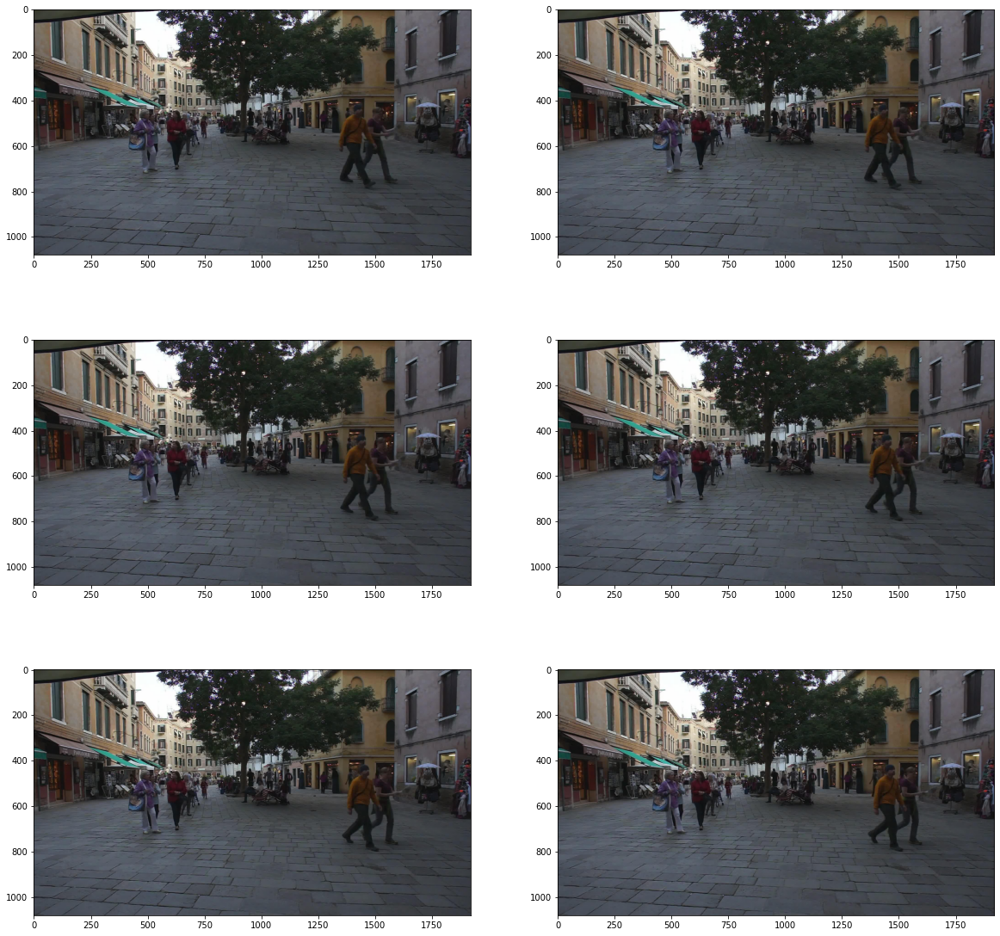

In [ ]:
images = [
  './train/MOT17-02/img1/000001.jpg',
  './train/MOT17-02/img1/000002.jpg',
  './train/MOT17-02/img1/000003.jpg',
  './train/MOT17-02/img1/000004.jpg',      
  './train/MOT17-02/img1/000005.jpg',
  './train/MOT17-02/img1/000006.jpg'    
]

display_grid(images, 3, 2)


## Download torchvision and coco

First, we need to install `pycocotools`. This library will be used for computing the evaluation metrics following the COCO metric for intersection over union.

In `references/detection/,` we have a number of helper functions to simplify training and evaluating detection models.
Here, we will use `references/detection/engine.py`, `references/detection/utils.py` and `references/detection/transforms.py`.

Let's copy those files (and their dependencies) in here so that they are available in the notebook

In [ ]:
from google.colab import drive

drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
%%shell

# Install pycocotools
git clone https://github.com/cocodataset/cocoapi.git
cd cocoapi/PythonAPI
python setup.py build_ext install

Cloning into 'cocoapi'...
remote: Enumerating objects: 975, done.
remote: Total 975 (delta 0), reused 0 (delta 0), pack-reused 975
Receiving objects: 100% (975/975), 11.72 MiB | 29.00 MiB/s, done.
Resolving deltas: 100% (576/576), done.
running build_ext
cythoning pycocotools/_mask.pyx to pycocotools/_mask.c
/usr/local/lib/python3.7/dist-packages/Cython/Compiler/Main.py:369: FutureWarning: Cython directive 'language_level' not set, using 2 for now (Py2). This will change in a later release! File: /content/tracking_wo_bnw/cocoapi/PythonAPI/pycocotools/_mask.pyx
  tree = Parsing.p_module(s, pxd, full_module_name)
building 'pycocotools._mask' extension
creating build
creating build/common
creating build/temp.linux-x86_64-3.7
creating build/temp.linux-x86_64-3.7/pycocotools
x86_64-linux-gnu-gcc -pthread -Wno-unused-result -Wsign-compare -DNDEBUG -g -fwrapv -O2 -Wall -g -fdebug-prefix-map=/build/python3.7-Y7dWVB/python3.7-3.7.12=. -fstack-protector-strong -Wformat -Werror=format-security -g

In [ ]:
%%shell

# Download TorchVision repo to use some files from
# references/detection
git clone https://github.com/pytorch/vision.git
cd vision
git checkout v0.3.0

cp references/detection/utils.py ../
cp references/detection/transforms.py ../
cp references/detection/coco_eval.py ../
cp references/detection/engine.py ../
cp references/detection/coco_utils.py ../

Cloning into 'vision'...
remote: Enumerating objects: 57884, done.
remote: Counting objects: 100% (23355/23355), done.
remote: Compressing objects: 100% (3790/3790), done.
remote: Total 57884 (delta 19900), reused 22475 (delta 19343), pack-reused 34529
Receiving objects: 100% (57884/57884), 110.04 MiB | 37.99 MiB/s, done.
Resolving deltas: 100% (46455/46455), done.
Note: checking out 'v0.3.0'.

You are in 'detached HEAD' state. You can look around, make experimental
changes and commit them, and you can discard any commits you make in this
state without impacting any branches by performing another checkout.

If you want to create a new branch to retain commits you create, you may
do so (now or later) by using -b with the checkout command again. Example:

  git checkout -b <new-branch-name>

HEAD is now at be376084 version check against PyTorch's CUDA version


## Defining the Dataset

The [torchvision reference scripts for training object detection, instance segmentation and person keypoint detection](https://github.com/pytorch/vision/tree/v0.3.0/references/detection) allows for easily supporting adding new custom datasets.
The dataset should inherit from the standard `torch.utils.data.Dataset` class, and implement `__len__` and `__getitem__`.

The only specificity that we require is that the dataset `__getitem__` should return:

* image: a PIL Image of size (H, W)
* target: a dict containing the following fields
    * `boxes` (`FloatTensor[N, 4]`): the coordinates of the `N` bounding boxes in `[x0, y0, x1, y1]` format, ranging from `0` to `W` and `0` to `H`
    * `labels` (`Int64Tensor[N]`): the label for each bounding box
    * `image_id` (`Int64Tensor[1]`): an image identifier. It should be unique between all the images in the dataset, and is used during evaluation
    * `area` (`Tensor[N]`): The area of the bounding box. This is used during evaluation with the COCO metric, to separate the metric scores between small, medium and large boxes.
    * `iscrowd` (`UInt8Tensor[N]`): instances with `iscrowd=True` will be ignored during evaluation.
    * (optionally) `masks` (`UInt8Tensor[N, H, W]`): The segmentation masks for each one of the objects
    * (optionally) `keypoints` (`FloatTensor[N, K, 3]`): For each one of the `N` objects, it contains the `K` keypoints in `[x, y, visibility]` format, defining the object. `visibility=0` means that the keypoint is not visible. Note that for data augmentation, the notion of flipping a keypoint is dependent on the data representation, and you should probably adapt `references/detection/transforms.py` for your new keypoint representation

If your model returns the above methods, they will make it work for both training and evaluation, and will use the evaluation scripts from pycocotools.

Additionally, if you want to use aspect ratio grouping during training (so that each batch only contains images with similar aspect ratio), then it is recommended to also implement a `get_height_and_width` method, which returns the height and the width of the image. If this method is not provided, we query all elements of the dataset via `__getitem__` , which loads the image in memory and is slower than if a custom method is provided.


So each image has a corresponding segmentation mask, where each color correspond to a different instance. Let's write a `torch.utils.data.Dataset` class for this dataset.

In [ ]:
import configparser
import csv
import os
import os.path as osp
import pickle

from PIL import Image
import numpy as np
import scipy
import torch


class MOT17ObjDetect(torch.utils.data.Dataset):
    """ Data class for the Multiple Object Tracking Dataset
    """

    def __init__(self, root, transforms=None, vis_threshold=0.25):
        self.root = root
        self.transforms = transforms
        self._vis_threshold = vis_threshold
        self._classes = ('background', 'pedestrian')
        self._img_paths = []

        for f in os.listdir(root):
            path = os.path.join(root, f)
            config_file = os.path.join(path, 'seqinfo.ini')

            assert os.path.exists(config_file), \
                'Path does not exist: {}'.format(config_file)

            config = configparser.ConfigParser()
            config.read(config_file)
            seq_len = int(config['Sequence']['seqLength'])
            im_width = int(config['Sequence']['imWidth'])
            im_height = int(config['Sequence']['imHeight'])
            im_ext = config['Sequence']['imExt']
            im_dir = config['Sequence']['imDir']

            _imDir = os.path.join(path, im_dir)

            for i in range(1, seq_len + 1):
                img_path = os.path.join(_imDir, f"{i:06d}{im_ext}")
                assert os.path.exists(img_path), \
                    'Path does not exist: {img_path}'
                # self._img_paths.append((img_path, im_width, im_height))
                self._img_paths.append(img_path)

    @property
    def num_classes(self):
        return len(self._classes)

    def _get_annotation(self, idx):
        """
        """

        if 'test' in self.root:
          
            num_objs = 0
            boxes = torch.zeros((num_objs, 4), dtype=torch.float32)

            return {'boxes': boxes,
                'labels': torch.ones((num_objs,), dtype=torch.int64),
                'image_id': torch.tensor([idx]),
                'area': (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0]),
                'iscrowd': torch.zeros((num_objs,), dtype=torch.int64),
                'visibilities': torch.zeros((num_objs), dtype=torch.float32)}
                
        img_path = self._img_paths[idx]
        file_index = int(os.path.basename(img_path).split('.')[0])

        gt_file = os.path.join(os.path.dirname(
            os.path.dirname(img_path)), 'gt', 'gt.txt')

        assert os.path.exists(gt_file), \
            'GT file does not exist: {}'.format(gt_file)

        bounding_boxes = []

        with open(gt_file, "r") as inf:
            reader = csv.reader(inf, delimiter=',')
            for row in reader:
                visibility = float(row[8])
                if int(row[0]) == file_index and int(row[6]) == 1 and int(row[7]) == 1 and visibility >= self._vis_threshold:
                    bb = {}
                    bb['bb_left'] = int(row[2])
                    bb['bb_top'] = int(row[3])
                    bb['bb_width'] = int(row[4])
                    bb['bb_height'] = int(row[5])
                    bb['visibility'] = float(row[8])

                    bounding_boxes.append(bb)

        num_objs = len(bounding_boxes)

        boxes = torch.zeros((num_objs, 4), dtype=torch.float32)
        visibilities = torch.zeros((num_objs), dtype=torch.float32)
        
        for i, bb in enumerate(bounding_boxes):
            # Make pixel indexes 0-based, should already be 0-based (or not)
            x1 = bb['bb_left'] - 1
            y1 = bb['bb_top'] - 1
            # This -1 accounts for the width (width of 1 x1=x2)
            x2 = x1 + bb['bb_width'] - 1
            y2 = y1 + bb['bb_height'] - 1

            boxes[i, 0] = x1
            boxes[i, 1] = y1
            boxes[i, 2] = x2
            boxes[i, 3] = y2
            visibilities[i] = bb['visibility']
            
        return {'boxes': boxes,
                'labels': torch.ones((num_objs,), dtype=torch.int64),
                'image_id': torch.tensor([idx]),
                'area': (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0]),
                'iscrowd': torch.zeros((num_objs,), dtype=torch.int64),
                'visibilities': visibilities,}

    def __getitem__(self, idx):
        # load images ad masks
        img_path = self._img_paths[idx]
        # mask_path = os.path.join(self.root, "PedMasks", self.masks[idx])
        img = Image.open(img_path).convert("RGB")

        target = self._get_annotation(idx)

        if self.transforms is not None:
            img, target = self.transforms(img, target)

        return img, target

    def __len__(self):
        return len(self._img_paths)
    
    def write_results_files(self, results, output_dir):
        """Write the detections in the format for MOT17Det sumbission

        all_boxes[image] = N x 5 array of detections in (x1, y1, x2, y2, score)

        Each file contains these lines:
        <frame>, <id>, <bb_left>, <bb_top>, <bb_width>, <bb_height>, <conf>, <x>, <y>, <z>

        Files to sumbit:
        ./MOT17-01.txt
        ./MOT17-02.txt
        ./MOT17-03.txt
        ./MOT17-04.txt
        ./MOT17-05.txt
        ./MOT17-06.txt
        ./MOT17-07.txt
        ./MOT17-08.txt
        ./MOT17-09.txt
        ./MOT17-10.txt
        ./MOT17-11.txt
        ./MOT17-12.txt
        ./MOT17-13.txt
        ./MOT17-14.txt
        """

        #format_str = "{}, -1, {}, {}, {}, {}, {}, -1, -1, -1"

        files = {}
        for image_id, res in results.items():
            path = self._img_paths[image_id]
            img1, name = osp.split(path)
            # get image number out of name
            frame = int(name.split('.')[0])
            # smth like /train/MOT17-09-FRCNN or /train/MOT17-09
            tmp = osp.dirname(img1)
            # get the folder name of the sequence and split it
            tmp = osp.basename(tmp).split('-')
            # Now get the output name of the file
            out = tmp[0]+'-'+tmp[1]+'.txt'
            outfile = osp.join(output_dir, out)

            # check if out in keys and create empty list if not
            if outfile not in files.keys():
                files[outfile] = []

            for box, score in zip(res['boxes'], res['scores']):
                x1 = box[0].item()
                y1 = box[1].item()
                x2 = box[2].item()
                y2 = box[3].item()
                files[outfile].append(
                    [frame, -1, x1, y1, x2 - x1, y2 - y1, score.item(), -1, -1, -1])

        for k, v in files.items():
            with open(k, "w") as of:
                writer = csv.writer(of, delimiter=',')
                for d in v:
                    writer.writerow(d)

    def print_eval(self, results, ovthresh=0.5):
        """Evaluates the detections (not official!!)

        all_boxes[cls][image] = N x 5 array of detections in (x1, y1, x2, y2, score)
        """

        if 'test' in self.root:
            print('No GT data available for evaluation.')
            return
            
        # Lists for tp and fp in the format tp[cls][image]
        tp = [[] for _ in range(len(self._img_paths))]
        fp = [[] for _ in range(len(self._img_paths))]

        npos = 0
        gt = []
        gt_found = []

        for idx in range(len(self._img_paths)):
            annotation = self._get_annotation(idx)
            bbox = annotation['boxes'][annotation['visibilities'].gt(self._vis_threshold)]
            found = np.zeros(bbox.shape[0])
            gt.append(bbox.cpu().numpy())
            gt_found.append(found)

            npos += found.shape[0]

        # Loop through all images
        # for res in results:
        for im_index, (im_gt, found) in enumerate(zip(gt, gt_found)):
            # Loop through dets an mark TPs and FPs
            
            # im_index = res['image_id'].item()
            # im_det = results['boxes']
            # annotation = self._get_annotation(im_index)
            # im_gt = annotation['boxes'][annotation['visibilities'].gt(0.5)].cpu().numpy()
            # found = np.zeros(im_gt.shape[0])
            
            im_det = results[im_index]['boxes'].cpu().numpy()

            im_tp = np.zeros(len(im_det))
            im_fp = np.zeros(len(im_det))
            for i, d in enumerate(im_det):
                ovmax = -np.inf

                if im_gt.size > 0:
                    # compute overlaps
                    # intersection
                    ixmin = np.maximum(im_gt[:, 0], d[0])
                    iymin = np.maximum(im_gt[:, 1], d[1])
                    ixmax = np.minimum(im_gt[:, 2], d[2])
                    iymax = np.minimum(im_gt[:, 3], d[3])
                    iw = np.maximum(ixmax - ixmin + 1., 0.)
                    ih = np.maximum(iymax - iymin + 1., 0.)
                    inters = iw * ih

                    # union
                    uni = ((d[2] - d[0] + 1.) * (d[3] - d[1] + 1.) +
                            (im_gt[:, 2] - im_gt[:, 0] + 1.) *
                            (im_gt[:, 3] - im_gt[:, 1] + 1.) - inters)

                    overlaps = inters / uni
                    ovmax = np.max(overlaps)
                    jmax = np.argmax(overlaps)

                if ovmax > ovthresh:
                    if found[jmax] == 0:
                        im_tp[i] = 1.
                        found[jmax] = 1.
                    else:
                        im_fp[i] = 1.
                else:
                    im_fp[i] = 1.

            tp[im_index] = im_tp
            fp[im_index] = im_fp

        # Flatten out tp and fp into a numpy array
        i = 0
        for im in tp:
            if type(im) != type([]):
                i += im.shape[0]

        tp_flat = np.zeros(i)
        fp_flat = np.zeros(i)

        i = 0
        for tp_im, fp_im in zip(tp, fp):
            if type(tp_im) != type([]):
                s = tp_im.shape[0]
                tp_flat[i:s+i] = tp_im
                fp_flat[i:s+i] = fp_im
                i += s

        tp = np.cumsum(tp_flat)
        fp = np.cumsum(fp_flat)
        rec = tp / float(npos)
        # avoid divide by zero in case the first detection matches a difficult
        # ground truth (probably not needed in my code but doesn't harm if left)
        prec = tp / np.maximum(tp + fp, np.finfo(np.float64).eps)
        tmp = np.maximum(tp + fp, np.finfo(np.float64).eps)

        # correct AP calculation
        # first append sentinel values at the end
        mrec = np.concatenate(([0.], rec, [1.]))
        mpre = np.concatenate(([0.], prec, [0.]))

        # compute the precision envelope
        for i in range(mpre.size - 1, 0, -1):
            mpre[i - 1] = np.maximum(mpre[i - 1], mpre[i])

        # to calculate area under PR curve, look for points
        # where X axis (recall) changes value
        i = np.where(mrec[1:] != mrec[:-1])[0]

        # and sum (\Delta recall) * prec
        ap = np.sum((mrec[i + 1] - mrec[i]) * mpre[i + 1])

        tp, fp, prec, rec, ap = np.max(tp), np.max(fp), prec[-1], np.max(rec), ap
        
        print(f"AP: {ap} Prec: {prec} Rec: {rec} TP: {tp} FP: {fp}")


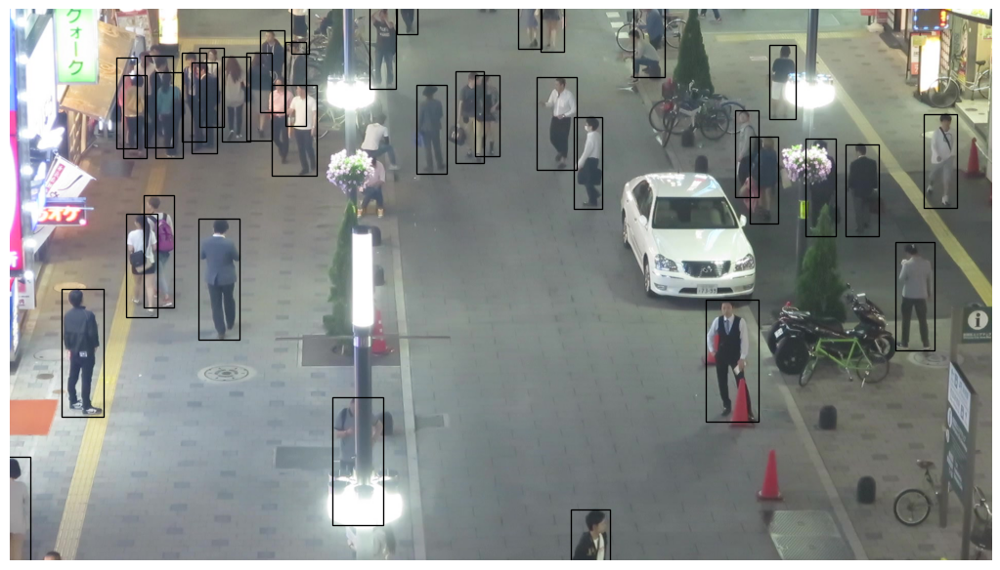

In [ ]:
import matplotlib.pyplot as plt
import transforms as T

dataset = MOT17ObjDetect('train')
img, target = dataset[0]

def plot(img, boxes):
  fig, ax = plt.subplots(1, dpi=96)

  img = img.mul(255).permute(1, 2, 0).byte().numpy()
  width, height, _ = img.shape
    
  ax.imshow(img, cmap='gray')
  fig.set_size_inches(width / 80, height / 80)

  for box in boxes:
      rect = plt.Rectangle(
        (box[0], box[1]),
        box[2] - box[0],
        box[3] - box[1],
        fill=False,
        linewidth=1.0)
      ax.add_patch(rect)

  plt.axis('off')
  plt.show()


img, target = T.ToTensor()(img, target)
plot(img, target['boxes'])

That's all for the dataset. Let's see how the outputs are structured for this dataset

In [ ]:
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor

      
def get_detection_model(num_classes):
    # load an instance segmentation model pre-trained on COCO
    model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)

    # get the number of input features for the classifier
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    # replace the pre-trained head with a new one
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)
    model.roi_heads.nms_thresh = 0.3
    
    return model

DATASETS

In [ ]:
from engine import train_one_epoch, evaluate
import utils


def get_transform(train):
    transforms = []
    # converts the image, a PIL image, into a PyTorch Tensor
    transforms.append(T.ToTensor())
    if train:
        # during training, randomly flip the training images
        # and ground-truth for data augmentation
        transforms.append(T.RandomHorizontalFlip(0.5))
    return T.Compose(transforms)

In [ ]:
# use our dataset and defined transformations
dataset = MOT17ObjDetect('train', get_transform(train=True))
dataset_no_random = MOT17ObjDetect('train', get_transform(train=False))
dataset_test = MOT17ObjDetect('test', get_transform(train=False))

# split the dataset in train and test set
torch.manual_seed(1)
# indices = torch.randperm(len(dataset)).tolist()
# dataset = torch.utils.data.Subset(dataset, indices[:-50])
# dataset_test = torch.utils.data.Subset(dataset_test, indices[-50:])

# define training and validation data loaders
data_loader = torch.utils.data.DataLoader(
    dataset, batch_size=2, shuffle=True, num_workers=4,
    collate_fn=utils.collate_fn)
data_loader_no_random = torch.utils.data.DataLoader(
    dataset_no_random, batch_size=1, shuffle=False, num_workers=4,
    collate_fn=utils.collate_fn)

data_loader_test = torch.utils.data.DataLoader(
    dataset_test, batch_size=1, shuffle=False, num_workers=4,
    collate_fn=utils.collate_fn)

INIT MODEL AND OPTIM

In [ ]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

# get the model using our helper function
model = get_detection_model(dataset.num_classes)
# move model to the right device
model.to(device)

# construct an optimizer
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.00001,
                            momentum=0.9, weight_decay=0.0005)

# and a learning rate scheduler which decreases the learning rate by
# 10x every 3 epochs
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer,
                                               step_size=10,
                                               gamma=0.1)

Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth


  0%|          | 0.00/160M [00:00<?, ?B/s]

TRAINING

In [ ]:
def evaluate_and_write_result_files(model, data_loader):
  model.eval()
  results = {}
  for imgs, targets in data_loader:
    imgs = [img.to(device) for img in imgs]

    with torch.no_grad():
        preds = model(imgs)
    
    for pred, target in zip(preds, targets):
        results[target['image_id'].item()] = {'boxes': pred['boxes'].cpu(),
                                              'scores': pred['scores'].cpu()}

  data_loader.dataset.print_eval(results)
  data_loader.dataset.write_results_files(results, '/content/gdrive/My Drive/Colab Notebooks/ee-596/hw-4/faster_rcnn_fpn_training_mot_17/resnet50/')
  
# evaluate_and_write_result_files(model, data_loader_test)
# evaluate_and_write_result_files(model, data_loader_no_random)

### Question B.1

(5 points) Use the provided pretrained Faster R-CNN to further train the model for 27 epochs on MOT-17 dataset. Use the sample codes to evaluate and report the accuracy of Average Precision (AP) on both train and test set. 


In [ ]:
# TODO
num_epochs = 27

for epoch in range(1, num_epochs + 1):
    train_one_epoch(model, optimizer, data_loader, device, epoch, print_freq=200)
    # update the learning rate
    # lr_scheduler.step()
    # evaluate on the test dataset
    if epoch % 3 == 0:      
      evaluate_and_write_result_files(model, data_loader_no_random)
      torch.save(model.state_dict(), f"/content/gdrive/My Drive/Colab Notebooks/ee-596/hw-4/faster_rcnn_fpn_training_mot_17/model_epoch_{epoch}.model")

Epoch: [1]  [   0/2658]  eta: 0:40:54  lr: 0.000010  loss: 0.5972 (0.5972)  loss_classifier: 0.1802 (0.1802)  loss_box_reg: 0.3913 (0.3913)  loss_objectness: 0.0027 (0.0027)  loss_rpn_box_reg: 0.0231 (0.0231)  time: 0.9235  data: 0.5500  max mem: 4316
Epoch: [1]  [ 200/2658]  eta: 0:14:38  lr: 0.000010  loss: 0.5855 (0.5214)  loss_classifier: 0.1528 (0.1541)  loss_box_reg: 0.3378 (0.3171)  loss_objectness: 0.0187 (0.0151)  loss_rpn_box_reg: 0.0378 (0.0351)  time: 0.3542  data: 0.0103  max mem: 4391
Epoch: [1]  [ 400/2658]  eta: 0:13:23  lr: 0.000010  loss: 0.4565 (0.5085)  loss_classifier: 0.1352 (0.1505)  loss_box_reg: 0.2974 (0.3101)  loss_objectness: 0.0171 (0.0144)  loss_rpn_box_reg: 0.0305 (0.0335)  time: 0.3546  data: 0.0098  max mem: 4391
Epoch: [1]  [ 600/2658]  eta: 0:12:11  lr: 0.000010  loss: 0.4508 (0.5141)  loss_classifier: 0.1285 (0.1523)  loss_box_reg: 0.2944 (0.3131)  loss_objectness: 0.0120 (0.0143)  loss_rpn_box_reg: 0.0290 (0.0343)  time: 0.3566  data: 0.0112  max me

In [ ]:
evaluate_and_write_result_files(model, data_loader_test)

No GT data available for evaluation.


**Report Accuracy**
* Val/Test: AP = 54% (27 Epochs)

(5 points) Randomly select some images and visualize their detection results.  


In [ ]:
import matplotlib as mpl

def visualize_preds(im_path, boxes):
    dpi = mpl.rcParams['figure.dpi']
    im_data = plt.imread(im_path)
    height, width, depth = im_data.shape

    figsize = width / float(dpi), height / float(dpi)
    fig = plt.figure(figsize=figsize)
    ax = fig.add_axes([0, 0, 1, 1])
    ax.axis('off')
    ax.imshow(im_data, cmap='gray')
    
    for box in boxes:
      rect = plt.Rectangle(
        (box[0], box[1]),
        box[2],
        box[3],
        fill=False,
        linewidth=2.0)
      ax.add_patch(rect)

    plt.show()


### Question B.2

In [ ]:
import pandas as pd

mot12_01_results = pd.read_csv(
  '/content/gdrive/MyDrive/Colab Notebooks/ee-596/hw-4/faster_rcnn_fpn_training_mot_17/resnet50/MOT17-01.txt', 
  header=None, 
  names=['frame', 'id', 'bb_left', 'bb_top', 'bb_width', 'bb_height', 'conf', 'x', 'y', 'z']
)

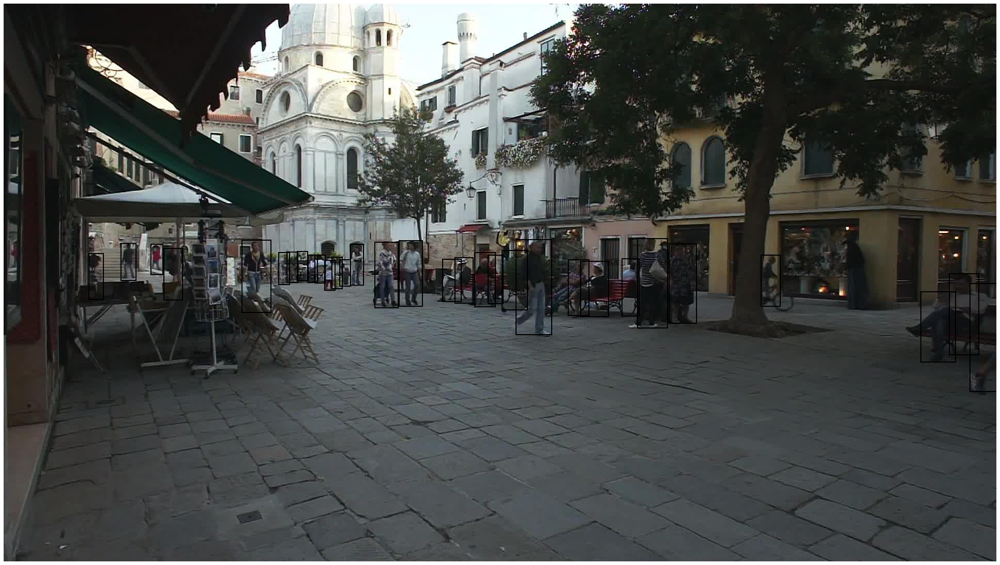

In [ ]:
boxes = mot12_01_results.loc[mot12_01_results["frame"] == 1][["bb_left", "bb_top", "bb_width", "bb_height"]]
visualize_preds('/content/tracking_wo_bnw/data/MOT17Det/test/MOT17-01/img1/000001.jpg', boxes.values)

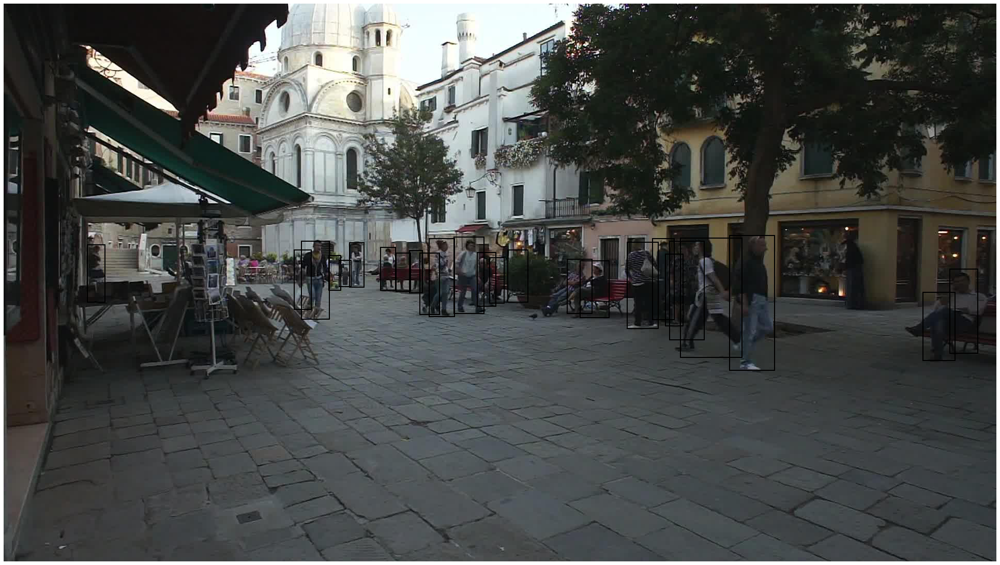

In [ ]:
boxes = mot12_01_results.loc[mot12_01_results["frame"] == 87][["bb_left", "bb_top", "bb_width", "bb_height"]]
visualize_preds('/content/tracking_wo_bnw/data/MOT17Det/test/MOT17-01/img1/000087.jpg', boxes.values)

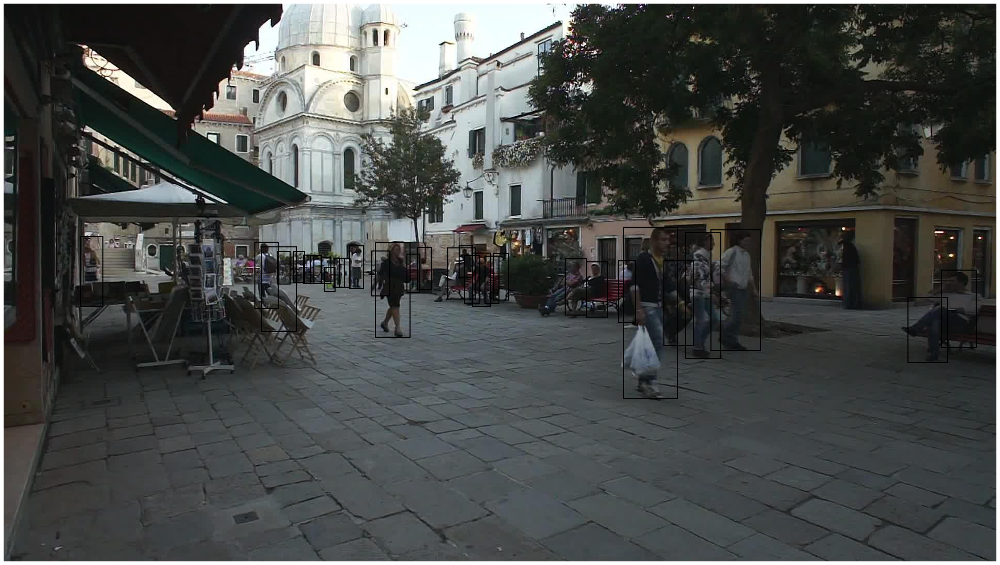

In [ ]:
boxes = mot12_01_results.loc[mot12_01_results["frame"] == 287][["bb_left", "bb_top", "bb_width", "bb_height"]]
visualize_preds('/content/tracking_wo_bnw/data/MOT17Det/test/MOT17-01/img1/000287.jpg', boxes.values)

In [ ]:
mot12_08_results = pd.read_csv(
  '/content/gdrive/MyDrive/Colab Notebooks/ee-596/hw-4/faster_rcnn_fpn_training_mot_17/resnet50/MOT17-08.txt', 
  header=None, 
  names=['frame', 'id', 'bb_left', 'bb_top', 'bb_width', 'bb_height', 'conf', 'x', 'y', 'z']
)

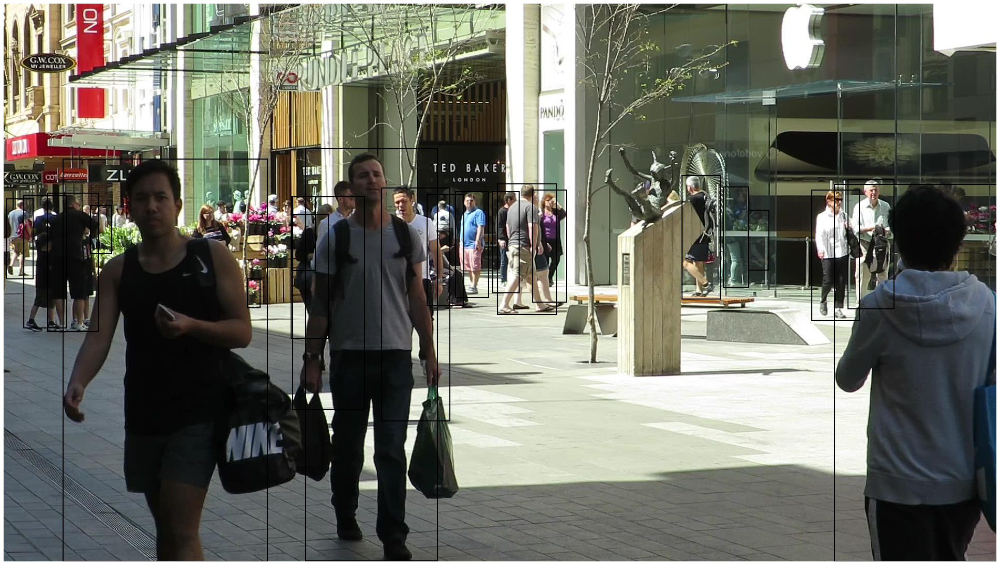

In [ ]:
boxes = mot12_08_results.loc[mot12_08_results["frame"] == 3][["bb_left", "bb_top", "bb_width", "bb_height"]]
visualize_preds('/content/tracking_wo_bnw/data/MOT17Det/test/MOT17-08/img1/000003.jpg', boxes.values)

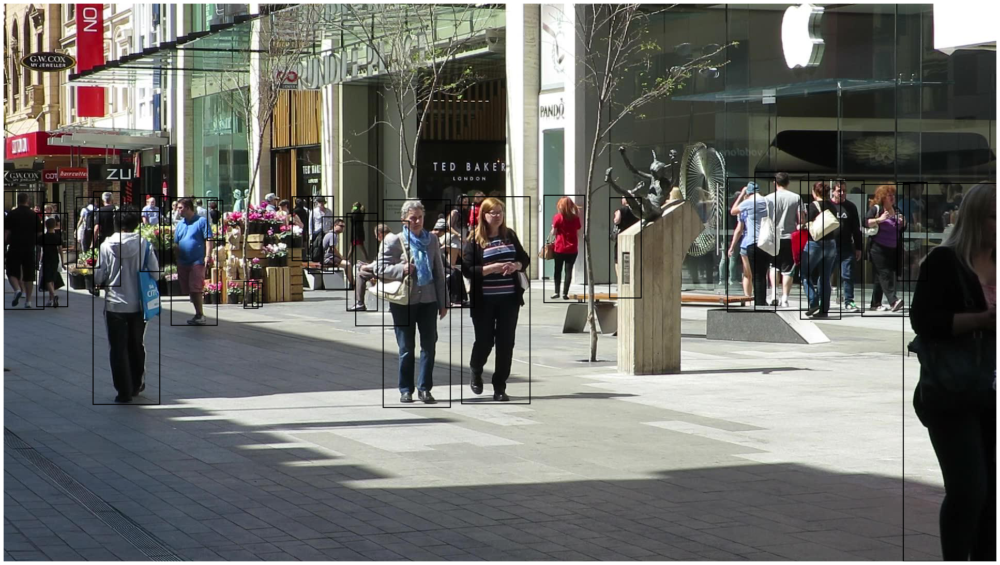

In [ ]:
boxes = mot12_08_results.loc[mot12_08_results["frame"] == 287][["bb_left", "bb_top", "bb_width", "bb_height"]]
visualize_preds('/content/tracking_wo_bnw/data/MOT17Det/test/MOT17-08/img1/000287.jpg', boxes.values)

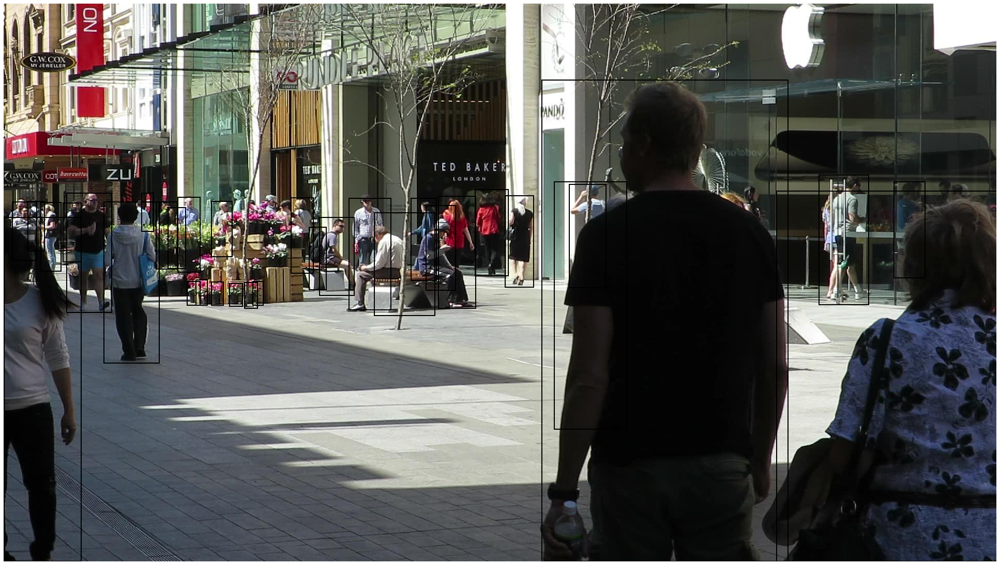

In [ ]:
boxes = mot12_08_results.loc[mot12_08_results["frame"] == 400][["bb_left", "bb_top", "bb_width", "bb_height"]]
visualize_preds('/content/tracking_wo_bnw/data/MOT17Det/test/MOT17-08/img1/000400.jpg', boxes.values)

The Tracktor can be configured by changing the corresponding experiments/cfgs/tracktor.yaml config file. The default configurations runs Tracktor with the FPN object detector are almost same as described in the paper except the Re-identification model is turned off (**do_reid=False, load_results=True**). 


(5 points) Run the inference experiments/scripts/test_tracktor.py using the MOT-17 train set input. The tracking results are logged in the corresponding `outputs/ ` folder. Open one of the generated results, explain what are the first six values generated in each line? (i.e., frame_id, bounding box (xywh/xyxy?), confidence, track_id, etc.). Plot the values on the corresponding images and show the video results. 

In [ ]:
%%shell

# There are some bugs casued by the previous installation
pip install motmetrics
pip install sacred==0.8.0
pip install PyYAML==5.1.2
pip install lap==0.4.0

  Using cached motmetrics-1.2.0-py3-none-any.whl (151 kB)
  Using cached flake8_import_order-0.18.1-py2.py3-none-any.whl (15 kB)
     |████████████████████████████████| 64 kB 2.1 MB/s 
  Using cached pytest_benchmark-3.4.1-py2.py3-none-any.whl (50 kB)
     |████████████████████████████████| 42 kB 968 kB/s 
  Using cached mccabe-0.6.1-py2.py3-none-any.whl (8.6 kB)
     |████████████████████████████████| 69 kB 7.8 MB/s 
     |████████████████████████████████| 280 kB 49.0 MB/s 
     |████████████████████████████████| 99 kB 10.3 MB/s 
  Using cached pytest-6.2.4-py3-none-any.whl (280 kB)
     |████████████████████████████████| 280 kB 53.7 MB/s 
     |████████████████████████████████| 280 kB 67.8 MB/s 
     |████████████████████████████████| 279 kB 41.7 MB/s 
     |████████████████████████████████| 279 kB 51.2 MB/s 
     |████████████████████████████████| 272 kB 51.6 MB/s 
     |████████████████████████████████| 272 kB 39.2 MB/s 
     |████████████████████████████████| 272 kB 53.8 MB/s 
   

In [ ]:
%cd /content
!git clone https://github.com/KaiyangZhou/deep-person-reid.git

/content
Cloning into 'deep-person-reid'...
remote: Enumerating objects: 9809, done.
remote: Counting objects: 100% (840/840), done.
remote: Compressing objects: 100% (107/107), done.
remote: Total 9809 (delta 761), reused 733 (delta 733), pack-reused 8969
Receiving objects: 100% (9809/9809), 9.48 MiB | 19.03 MiB/s, done.
Resolving deltas: 100% (7280/7280), done.


In [ ]:
% cd deep-person-reid
!pip install -r requirements.txt
!python setup.py develop

/content/deep-person-reid
     |████████████████████████████████| 5.8 MB 7.3 MB/s 
     |████████████████████████████████| 185 kB 48.7 MB/s 
  Using cached isort-4.3.21-py2.py3-none-any.whl (42 kB)
     |████████████████████████████████| 64 kB 2.7 MB/s 
     |████████████████████████████████| 73 kB 1.8 MB/s 
  Using cached pycodestyle-2.7.0-py2.py3-none-any.whl (41 kB)
  Using cached pyflakes-2.3.1-py2.py3-none-any.whl (68 kB)
  Attempting uninstall: importlib-metadata
    Found existing installation: importlib-metadata 4.2.0
    Uninstalling importlib-metadata-4.2.0:
      Successfully uninstalled importlib-metadata-4.2.0
  Attempting uninstall: pyflakes
    Found existing installation: pyflakes 2.4.0
    Uninstalling pyflakes-2.4.0:
      Successfully uninstalled pyflakes-2.4.0
  Attempting uninstall: pycodestyle
    Found existing installation: pycodestyle 2.8.0
    Uninstalling pycodestyle-2.8.0:
      Successfully uninstalled pycodestyle-2.8.0
  Attempting uninstall: flake8
    Fo

In [ ]:
% cd /content/tracking_wo_bnw
!wget https://motchallenge.net/data/MOT17.zip
!unzip -q -d data MOT17.zip

/content/tracking_wo_bnw
--2021-11-27 18:37:17--  https://motchallenge.net/data/MOT17.zip
Resolving motchallenge.net (motchallenge.net)... 131.159.19.34, 2a09:80c0:18::1034
Connecting to motchallenge.net (motchallenge.net)|131.159.19.34|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 5860214001 (5.5G) [application/zip]
Saving to: ‘MOT17.zip’

MOT17.zip           100%[===================>]   5.46G  14.6MB/s    in 6m 22s  

2021-11-27 18:43:40 (14.6 MB/s) - ‘MOT17.zip’ saved [5860214001/5860214001]



In [ ]:
%%shell
wget https://vision.in.tum.de/webshare/u/meinhard/tracking_wo_bnw-output_v5.zip .
unzip -q tracking_wo_bnw-output_v5.zip 

--2021-11-27 18:46:34--  https://vision.in.tum.de/webshare/u/meinhard/tracking_wo_bnw-output_v5.zip
Resolving vision.in.tum.de (vision.in.tum.de)... 131.159.19.110, 2a09:80c0:18::1110
Connecting to vision.in.tum.de (vision.in.tum.de)|131.159.19.110|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 771143868 (735M) [application/zip]
Saving to: ‘tracking_wo_bnw-output_v5.zip’

tracking_wo_bnw-out 100%[===================>] 735.42M  18.8MB/s    in 42s     

2021-11-27 18:47:16 (17.6 MB/s) - ‘tracking_wo_bnw-output_v5.zip’ saved [771143868/771143868]

--2021-11-27 18:47:16--  http://./
Resolving . (.)... failed: No address associated with hostname.
wget: unable to resolve host address ‘.’
FINISHED --2021-11-27 18:47:16--
Total wall clock time: 43s
Downloaded: 1 files, 735M in 42s (17.6 MB/s)
replace output/tracktor/MOT20/.DS_Store? [y]es, [n]o, [A]ll, [N]one, [r]ename: A


### Question C.1

In [ ]:
!python experiments/scripts/test_tracktor.py

WARNING - test_tracktor - No observers have been added to this run
INFO - test_tracktor - Running command 'main'
INFO - test_tracktor - Started
Configuration (modified, added, typechanged, doc):
  dataset = 'mot17_train_FRCNN'
  desription = None
  interpolate = False
  load_results = True
  module_name = 'MOT17'
  name = 'Tracktor++'
  network = 'fpn'
  obj_detect_models = 'output/faster_rcnn_fpn_training_mot_17/model_epoch_27.model'
  oracle = None
  reid_models = 'output/tracktor/reid/market1501/model/model-last.pth.tar'
  seed = 12345
  write_images = True
  frame_range:
    end = 1.0
    start = 0.0
  tracker:
    detection_nms_thresh = 0.3
    detection_person_thresh = 0.5
    do_align = True
    do_reid = False
    inactive_patience = 50
    max_features_num = 10
    number_of_iterations = 100
    public_detections = True
    regression_nms_thresh = 0.6
    regression_person_thresh = 0.5
    reid_iou_threshold = 0.0
    reid_sim_threshold = 200.0
    termination_eps = 1e-05
    

The results are logged in the corresponding `output` directory.

**Question:** Explain what the first six values are generated in each line? 

* 1 - the image number itself
* 2 - the id of the object being tracked/associated
* 3 - left coordinate of the bounding box
* 4 - top coordinate of the bounding box
* 5 - width of the bounding box 
* 6 - height of the bounding box 



**Plot Some Images:**

In [ ]:
mot17_11_results = pd.read_csv(
  '/content/tracking_wo_bnw/output/tracktor/MOT17/Tracktor++/MOT17-11-FRCNN', 
  header=None, 
  names=['frame', 'id', 'bb_left', 'bb_top', 'bb_width', 'bb_height', 'conf', 'x', 'y', 'z']
)

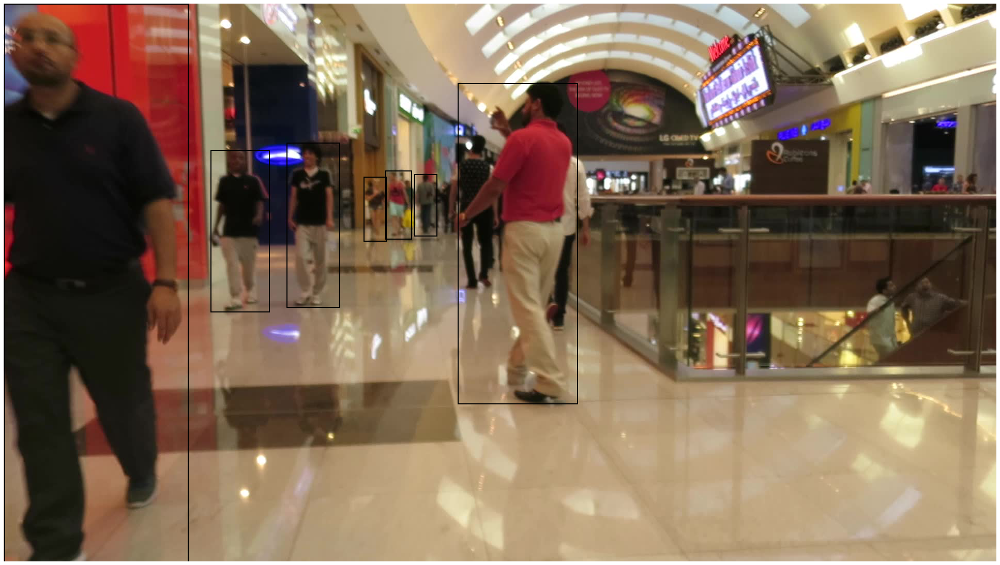

In [ ]:
boxes = mot17_11_results.loc[mot17_11_results["frame"] == 1][["bb_left", "bb_top", "bb_width", "bb_height"]]
visualize_preds(f'/content/tracking_wo_bnw/data/MOT17/train/MOT17-11-FRCNN/img1/000001.jpg', boxes.values)

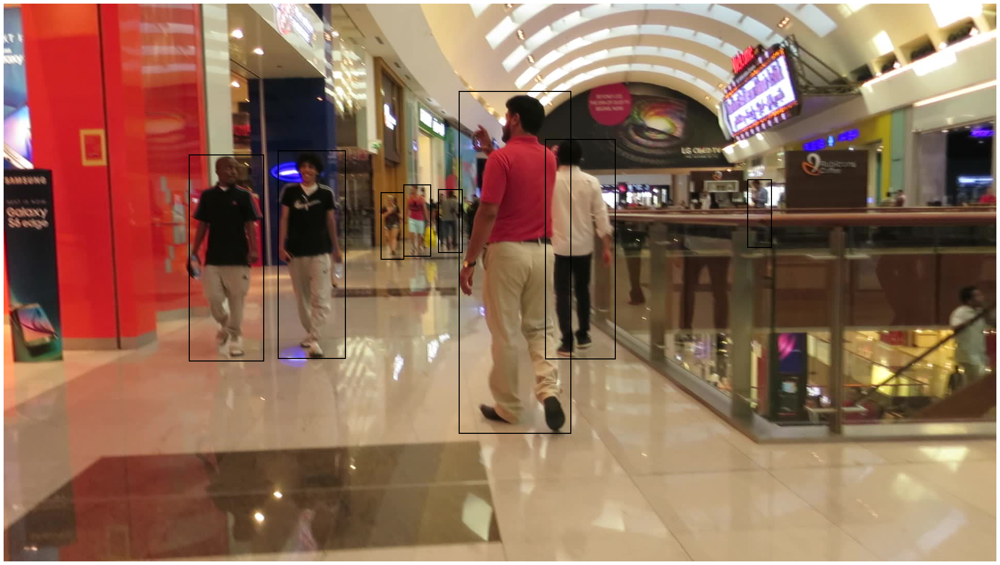

In [ ]:
boxes = mot17_11_results.loc[mot17_11_results["frame"] == 25][["bb_left", "bb_top", "bb_width", "bb_height"]]
visualize_preds(f'/content/tracking_wo_bnw/data/MOT17/train/MOT17-11-FRCNN/img1/000025.jpg', boxes.values)

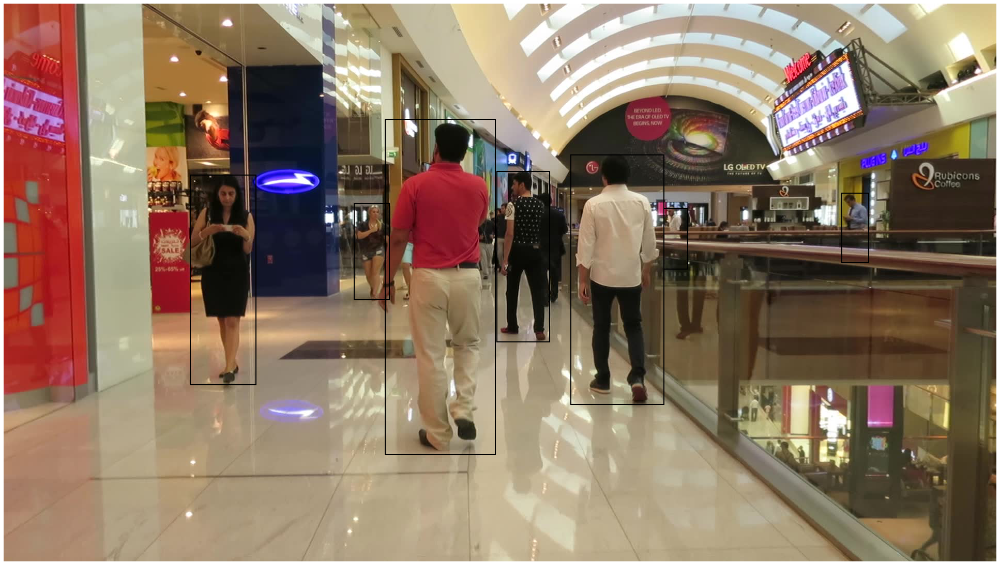

In [ ]:
boxes = mot17_11_results.loc[mot17_11_results["frame"] == 125][["bb_left", "bb_top", "bb_width", "bb_height"]]
visualize_preds(f'/content/tracking_wo_bnw/data/MOT17/train/MOT17-11-FRCNN/img1/000125.jpg', boxes.values)

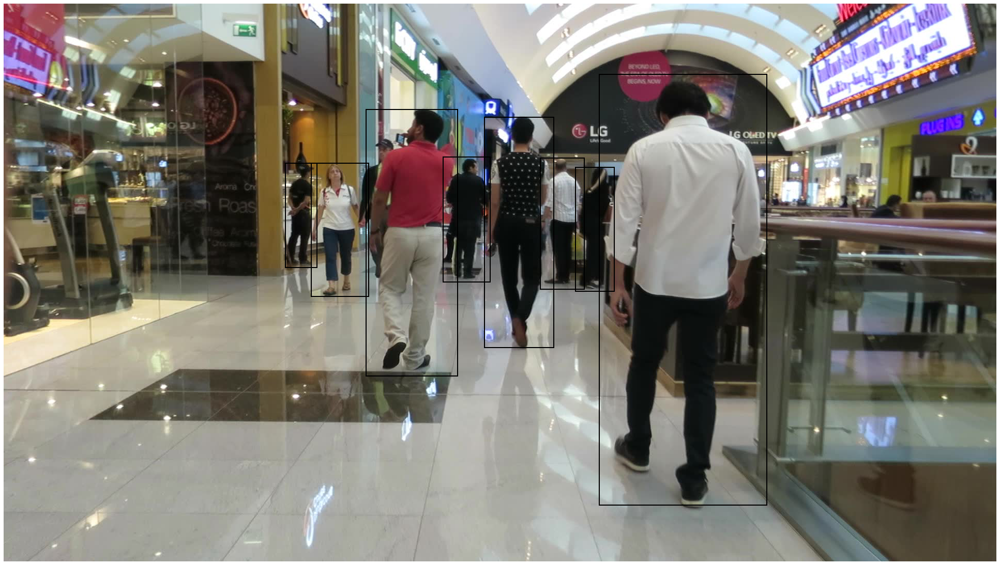

In [ ]:
boxes = mot17_11_results.loc[mot17_11_results["frame"] == 450][["bb_left", "bb_top", "bb_width", "bb_height"]]
visualize_preds(f'/content/tracking_wo_bnw/data/MOT17/train/MOT17-11-FRCNN/img1/000450.jpg', boxes.values)

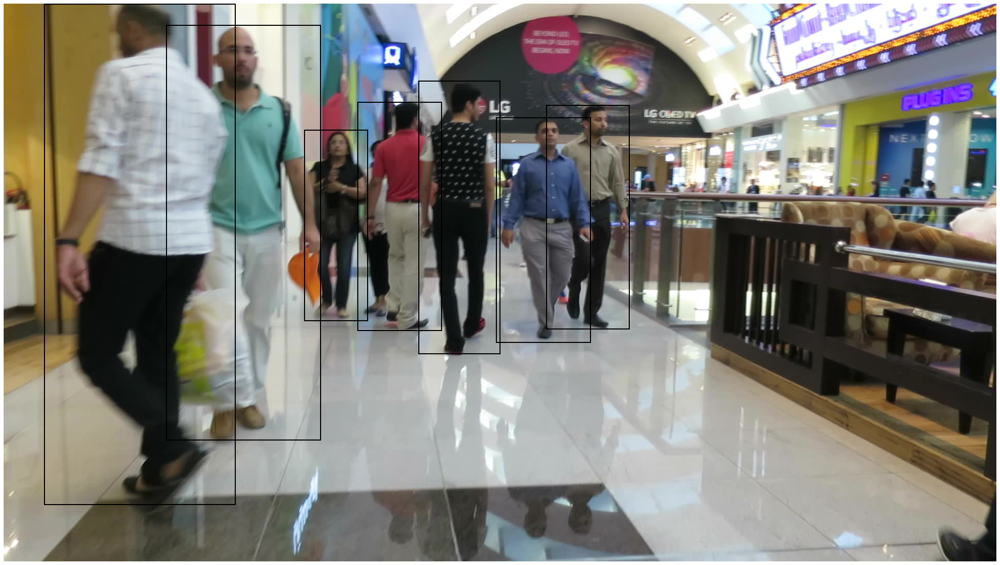

In [ ]:
boxes = mot17_11_results.loc[mot17_11_results["frame"] == 777][["bb_left", "bb_top", "bb_width", "bb_height"]]
visualize_preds(f'/content/tracking_wo_bnw/data/MOT17/train/MOT17-11-FRCNN/img1/000777.jpg', boxes.values)

**Show Video**

In [ ]:
!ffmpeg -f image2 -framerate 15 -start_number 800 -i /content/tracking_wo_bnw/output/tracktor/MOT17/Tracktor++/\<tracktor.datasets.factory.Datasets\ object\ at\ 0x7f2ac67c0590\>/MOT17-11-FRCNN/%06d.jpg -vcodec libx264 -y ./output/mot17_11.mp4 -vf scale=320:-1

ffmpeg version 3.4.8-0ubuntu0.2 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-lib

In [ ]:
def show_local_mp4_video(file_name, width=640, height=480):
  import io
  import base64
  from IPython.display import HTML
  video_encoded = base64.b64encode(io.open(file_name, 'rb').read())
  return HTML(data='''<video width="{0}" height="{1}" alt="test" controls>
                        <source src="data:video/mp4;base64,{2}" type="video/mp4" />
                      </video>'''.format(width, height, video_encoded.decode('ascii')))


### IMPORTANT:I included the full video in the zip file because it would crash colab. Maybe cause it's 50 Megs.

In [ ]:
show_local_mp4_video('/content/tracking_wo_bnw/output/mot17_11.mp4', width=320, height=320)

### Question C.2

(5 points) Evaluate the performance using test_tracktor.py and report the following metrics: MOTA, MOTP, IDF1, FP. (**Hints: These metrics have already been logged in Colab outputs from the previous problems. You can just copy down here.**) 

In [ ]:
"""
                IDF1   IDP   IDR  Rcll  Prcn  GT  MT  PT  ML  FP    FN IDs   FM  MOTA  MOTP IDt IDa IDm
MOT17-02-FRCNN 43.0% 73.6% 30.4% 41.2% 99.8%  62   8  32  22  16 10924  65   65 40.8% 0.079   9  59   3
MOT17-04-FRCNN 70.0% 88.9% 57.7% 64.7% 99.8%  83  32  29  22  66 16774  23   29 64.5% 0.096   5  20   2
MOT17-05-FRCNN 60.8% 82.5% 48.1% 57.4% 98.3% 133  32  64  37  67  2948  66   59 55.5% 0.142  11  60   5
MOT17-09-FRCNN 58.0% 73.7% 47.8% 64.2% 99.0%  26  11  13   2  33  1907  30   30 63.0% 0.087   6  26   2
MOT17-10-FRCNN 65.0% 76.5% 56.5% 72.4% 98.0%  57  28  26   3 185  3543  80  121 70.3% 0.146  14  64   2
MOT17-11-FRCNN 63.7% 77.6% 54.1% 69.0% 99.0%  75  24  33  18  67  2924  26   25 68.0% 0.082   7  22   4
MOT17-13-FRCNN 72.1% 83.5% 63.5% 74.2% 97.5% 110  59  40  11 217  3007 103   85 71.4% 0.130  29  86  12
OVERALL        64.1% 82.8% 52.3% 62.6% 99.1% 546 194 237 115 651 42027 393  414 61.6% 0.106  81 337  30
"""

(10 points) Run the inference test_tracktor.py with the changed configurations in experiments/cfgs/tracktor.yaml and evaluate the performance: 

* tracktor/tracker:
    * detection_person_thresh (FRCNN score threshold for detections): 0.5
    * detection_nms_thresh (NMS threshold for detection): 0.3
    * number_of_iterations (maximal number of iterations): 100
    * max_features_num (How much last appearance features are to keep): 10
    * motion_model (motion model settings, mentioned in 2.3): disabled

Feel free to change at least three hyperparameters (can be from detection or tracking). Discuss how these changes may affect the tracking performance based on MOTA. 


In [ ]:
!rm -rf /content/tracking_wo_bnw/output/tracktor/MOT17/Tracktor++/*

**Exp 1: Motion Model Enabled and Remainder Unchanged**

In [ ]:
!python experiments/scripts/test_tracktor.py

WARNING - test_tracktor - No observers have been added to this run
INFO - test_tracktor - Running command 'main'
INFO - test_tracktor - Started
Configuration (modified, added, typechanged, doc):
  dataset = 'mot17_train_FRCNN'
  desription = None
  interpolate = False
  load_results = True
  module_name = 'MOT17'
  name = 'Tracktor++'
  network = 'fpn'
  obj_detect_models = 'output/faster_rcnn_fpn_training_mot_17/model_epoch_27.model'
  oracle = None
  reid_models = 'output/tracktor/reid/market1501/model/model-last.pth.tar'
  seed = 12345
  write_images = False
  frame_range:
    end = 1.0
    start = 0.0
  tracker:
    detection_nms_thresh = 0.3
    detection_person_thresh = 0.5
    do_align = True
    do_reid = False
    inactive_patience = 50
    max_features_num = 10
    number_of_iterations = 200
    public_detections = True
    regression_nms_thresh = 0.6
    regression_person_thresh = 0.5
    reid_iou_threshold = 0.0
    reid_sim_threshold = 200.0
    termination_eps = 1e-05
   

**Results**

In [ ]:
"""
                IDF1   IDP   IDR  Rcll  Prcn  GT  MT  PT  ML  FP    FN IDs   FM  MOTA  MOTP IDt IDa IDm
MOT17-02-FRCNN 43.2% 74.0% 30.5% 41.1% 99.7%  62   9  31  22  24 10937  64   64 40.7% 0.078   8  59   3
MOT17-04-FRCNN 71.7% 91.4% 59.0% 64.4% 99.8%  83  34  27  22  70 16923  22   27 64.2% 0.095   3  21   2
MOT17-05-FRCNN 60.7% 82.2% 48.1% 57.5% 98.3% 133  32  64  37  70  2938  63   59 55.6% 0.141   8  58   3
MOT17-09-FRCNN 59.6% 76.2% 49.0% 63.7% 99.1%  26  11  13   2  32  1933  29   29 62.6% 0.077   4  27   2
MOT17-10-FRCNN 60.9% 71.8% 52.8% 72.2% 98.1%  57  27  27   3 181  3572  83  124 70.1% 0.145  11  73   3
MOT17-11-FRCNN 63.7% 77.5% 54.1% 68.9% 98.7%  75  24  33  18  83  2932  23   27 67.8% 0.075   4  22   3
MOT17-13-FRCNN 75.8% 88.2% 66.6% 74.1% 98.2% 110  58  42  10 162  3015  68   79 72.1% 0.129  24  53   9
OVERALL        64.8% 83.9% 52.8% 62.4% 99.1% 546 195 237 114 622 42250 352  409 61.5% 0.104  62 313  25
INFO - test_tracktor - Completed after 1:21:27
"""

**Exp 2: number_of_iterations = 300 and Remainder Unchanged**

In [ ]:
!python experiments/scripts/test_tracktor.py

WARNING - test_tracktor - No observers have been added to this run
INFO - test_tracktor - Running command 'main'
INFO - test_tracktor - Started
Configuration (modified, added, typechanged, doc):
  dataset = 'mot17_train_FRCNN'
  desription = None
  interpolate = False
  load_results = True
  module_name = 'MOT17'
  name = 'Tracktor++'
  network = 'fpn'
  obj_detect_models = 'output/faster_rcnn_fpn_training_mot_17/model_epoch_27.model'
  oracle = None
  reid_models = 'output/tracktor/reid/market1501/model/model-last.pth.tar'
  seed = 12345
  write_images = False
  frame_range:
    end = 1.0
    start = 0.0
  tracker:
    detection_nms_thresh = 0.3
    detection_person_thresh = 0.5
    do_align = True
    do_reid = False
    inactive_patience = 50
    max_features_num = 10
    number_of_iterations = 300
    public_detections = True
    regression_nms_thresh = 0.6
    regression_person_thresh = 0.5
    reid_iou_threshold = 0.0
    reid_sim_threshold = 200.0
    termination_eps = 1e-05
   

**Results**

In [ ]:
"""
                IDF1   IDP   IDR  Rcll  Prcn  GT  MT  PT  ML  FP    FN IDs   FM  MOTA  MOTP IDt IDa IDm
MOT17-02-FRCNN 43.0% 73.6% 30.4% 41.2% 99.8%  62   8  32  22  16 10924  65   65 40.8% 0.079   9  59   3
MOT17-04-FRCNN 70.0% 88.9% 57.7% 64.7% 99.8%  83  32  29  22  66 16774  23   29 64.5% 0.096   5  20   2
MOT17-05-FRCNN 60.8% 82.5% 48.1% 57.4% 98.3% 133  32  64  37  67  2948  66   59 55.5% 0.142  11  60   5
MOT17-09-FRCNN 58.0% 73.7% 47.8% 64.2% 99.0%  26  11  13   2  33  1907  30   30 63.0% 0.087   6  26   2
MOT17-10-FRCNN 65.0% 76.5% 56.5% 72.4% 98.0%  57  28  26   3 185  3543  80  121 70.3% 0.146  14  64   2
MOT17-11-FRCNN 63.7% 77.6% 54.1% 69.0% 99.0%  75  24  33  18  67  2924  26   25 68.0% 0.082   7  22   4
MOT17-13-FRCNN 72.1% 83.5% 63.5% 74.2% 97.5% 110  59  40  11 217  3007 103   85 71.4% 0.130  29  86  12
OVERALL        64.1% 82.8% 52.3% 62.6% 99.1% 546 194 237 115 651 42027 393  414 61.6% 0.106  81 337  30
"""

**Exp 3** - detection_person_thresh = 0.7, max_features_num = 15

In [ ]:
!python experiments/scripts/test_tracktor.py

WARNING - test_tracktor - No observers have been added to this run
INFO - test_tracktor - Running command 'main'
INFO - test_tracktor - Started
Configuration (modified, added, typechanged, doc):
  dataset = 'mot17_train_FRCNN'
  desription = None
  interpolate = False
  load_results = True
  module_name = 'MOT17'
  name = 'Tracktor++'
  network = 'fpn'
  obj_detect_models = 'output/faster_rcnn_fpn_training_mot_17/model_epoch_27.model'
  oracle = None
  reid_models = 'output/tracktor/reid/market1501/model/model-last.pth.tar'
  seed = 12345
  write_images = False
  frame_range:
    end = 1.0
    start = 0.0
  tracker:
    detection_nms_thresh = 0.3
    detection_person_thresh = 0.7
    do_align = True
    do_reid = False
    inactive_patience = 50
    max_features_num = 15
    number_of_iterations = 100
    public_detections = True
    regression_nms_thresh = 0.6
    regression_person_thresh = 0.5
    reid_iou_threshold = 0.0
    reid_sim_threshold = 200.0
    termination_eps = 1e-05
   

**Results**

In [ ]:
"""
                IDF1   IDP   IDR  Rcll  Prcn  GT  MT  PT  ML  FP    FN IDs   FM  MOTA  MOTP IDt IDa IDm
MOT17-02-FRCNN 43.0% 73.8% 30.3% 41.0% 99.8%  62   8  32  22  15 10956  63   64 40.6% 0.079   9  57   3
MOT17-04-FRCNN 70.0% 89.0% 57.7% 64.7% 99.8%  83  32  29  22  65 16786  23   29 64.5% 0.096   5  20   2
MOT17-05-FRCNN 60.7% 82.7% 48.0% 57.2% 98.5% 133  31  65  37  60  2963  65   58 55.4% 0.142  11  59   5
MOT17-09-FRCNN 58.0% 73.8% 47.8% 64.1% 99.1%  26  11  13   2  31  1910  29   30 63.0% 0.086   5  25   1
MOT17-10-FRCNN 65.1% 76.9% 56.4% 72.2% 98.3%  57  28  26   3 165  3574  74  115 70.3% 0.145  13  60   2
MOT17-11-FRCNN 63.7% 77.6% 54.0% 68.9% 99.0%  75  24  33  18  65  2930  26   25 68.0% 0.082   7  22   4
MOT17-13-FRCNN 72.2% 83.8% 63.4% 73.8% 97.7% 110  58  39  13 204  3048  91   80 71.3% 0.130  30  75  14
OVERALL        64.1% 82.9% 52.2% 62.5% 99.1% 546 192 237 117 605 42167 371  401 61.6% 0.105  80 318  31
"""

**Exp 4**: detection_person_thresh: 0.3,  motion_model: true,  max_features_num: 5

In [ ]:
!python experiments/scripts/test_tracktor.py

WARNING - test_tracktor - No observers have been added to this run
INFO - test_tracktor - Running command 'main'
INFO - test_tracktor - Started
Configuration (modified, added, typechanged, doc):
  dataset = 'mot17_train_FRCNN'
  desription = None
  interpolate = False
  load_results = True
  module_name = 'MOT17'
  name = 'Tracktor++'
  network = 'fpn'
  obj_detect_models = 'output/faster_rcnn_fpn_training_mot_17/model_epoch_27.model'
  oracle = None
  reid_models = 'output/tracktor/reid/market1501/model/model-last.pth.tar'
  seed = 12345
  write_images = False
  frame_range:
    end = 1.0
    start = 0.0
  tracker:
    detection_nms_thresh = 0.3
    detection_person_thresh = 0.3
    do_align = True
    do_reid = False
    inactive_patience = 50
    max_features_num = 5
    number_of_iterations = 100
    public_detections = True
    regression_nms_thresh = 0.6
    regression_person_thresh = 0.5
    reid_iou_threshold = 0.0
    reid_sim_threshold = 200.0
    termination_eps = 1e-05
    

**Results**

In [ ]:
"""
                IDF1   IDP   IDR  Rcll  Prcn  GT  MT  PT  ML  FP    FN IDs   FM  MOTA  MOTP IDt IDa IDm
MOT17-02-FRCNN 43.2% 73.7% 30.6% 41.3% 99.6%  62   9  31  22  28 10903  69   67 40.8% 0.079   9  64   4
MOT17-04-FRCNN 71.8% 91.4% 59.1% 64.5% 99.8%  83  34  27  22  73 16904  23   27 64.3% 0.095   3  22   2
MOT17-05-FRCNN 60.6% 81.9% 48.1% 57.6% 98.0% 133  32  65  36  83  2936  65   60 55.4% 0.141   9  60   4
MOT17-09-FRCNN 59.6% 76.2% 49.0% 63.7% 99.0%  26  11  13   2  33  1932  30   29 62.5% 0.077   4  28   2
MOT17-10-FRCNN 60.5% 71.0% 52.8% 72.3% 97.3%  57  27  27   3 259  3553  96  130 69.6% 0.145  11  86   3
MOT17-11-FRCNN 63.7% 77.4% 54.1% 69.0% 98.7%  75  24  33  18  86  2929  25   27 67.8% 0.075   4  24   3
MOT17-13-FRCNN 76.0% 87.9% 66.9% 74.6% 98.0% 110  60  40  10 177  2954  71   81 72.5% 0.130  24  56   9
OVERALL        64.8% 83.7% 52.9% 62.5% 99.0% 546 197 236 113 739 42111 379  421 61.5% 0.104  64 340  27
"""

**Observations**

* In the four experiments above there wasn't a lof change in the overall MOTA. 
* The last experiment provided improvements for specifice scenes. Namely MOT17-13-FRCNN. 

I wanna try out more values, but have run out of time.